In [1]:
import os
import scipy
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from collections import OrderedDict
import cv2
from PIL import Image
import keras
# For one-hot-encoding
from keras.utils import np_utils
# For creating sequenttial model
from keras.models import Sequential
from keras.layers import Conv2D,MaxPooling2D,Dense,Flatten,Dropout
# For saving and loading models
from keras.models import load_model


import random

In [2]:
# Simple EDA

In [3]:
classes = os.listdir('d:/project/kaggle/input/vehicle/train/train/')
BASE = 'd:/project/kaggle/input/vehicle/train/train/'

# create dict of list of images per class
dataset = {}
for vehicle in classes:
    dataset[vehicle] = [i for i in os.listdir(BASE + vehicle)]

In [4]:
# verify
print(dataset.keys())
print(len(dataset.keys()))

dict_keys(['chevrolet_impala_2007', 'chevrolet_impala_2008', 'chevrolet_impala_2009', 'chevrolet_silverado_2003', 'chevrolet_silverado_2004', 'dodge_ram_1500_1995', 'dodge_ram_1500_1996', 'dodge_ram_1500_1997', 'dodge_ram_1500_1998', 'dodge_ram_1500_1999', 'dodge_ram_1500_2000', 'dodge_ram_1500_2001', 'ford_f150_2005', 'ford_f150_2006', 'ford_f150_2007', 'gmc_sierra_1500_2007', 'gmc_sierra_1500_2008', 'gmc_sierra_1500_2009', 'gmc_sierra_1500_2010', 'gmc_sierra_1500_2011', 'gmc_sierra_1500_2012', 'gmc_sierra_1500_2013', 'gmc_sierra_2500_2007', 'gmc_sierra_2500_2008', 'gmc_sierra_2500_2009', 'gmc_sierra_2500_2010', 'gmc_sierra_2500_2011', 'gmc_sierra_2500_2013', 'honda_accord_1996', 'honda_accord_1997', 'honda_civic_1997', 'honda_civic_1998', 'nissan_altima_2013', 'nissan_altima_2014', 'nissan_altima_2015', 'toyota_camry_2012', 'toyota_camry_2013', 'toyota_camry_2014', 'toyota_camry_le_2012', 'toyota_camry_le_2013', 'toyota_camry_le_2014', 'toyota_camry_se_2012', 'toyota_camry_se_2013', 

- There are total 53 classes of vehicles

In [5]:
# convert dict to pandas df
df = pd.DataFrame.from_dict(dataset, orient='index')
df = df.transpose()

In [6]:
# train set
df.head()

,chevrolet_impala_2007,chevrolet_impala_2008,chevrolet_impala_2009,chevrolet_silverado_2003,chevrolet_silverado_2004,dodge_ram_1500_1995,dodge_ram_1500_1996,dodge_ram_1500_1997,dodge_ram_1500_1998,dodge_ram_1500_1999,...,toyota_camry_xle_2012,toyota_camry_xle_2013,toyota_corolla_2011,toyota_corolla_2012,toyota_corolla_2013,toyota_corolla_ce_2012,toyota_corolla_le_2012,toyota_corolla_le_2013,toyota_corolla_s_2011,toyota_corolla_s_2012
0,00101_7mjApj3wb7Y_600x450.jpg,00000_8xV8B4TpKMW_600x450.jpg,00404_2oZz8iFzGXf_600x450.jpg,2003 1500 chevy silverado_00E0E_gcAlN1wRYXi_60...,2004 2004 chevrolet 2500_00101_hdS8VocbY4Z_600...,1995 Dodge Ram 1500 Series_00B0B_edKEc6hVTw4_6...,1996 DODGE 1500 4X4_00d0d_dD02Y1E0rxI_600x450.jpg,1997 Dodge 1500 4x4_00O0O_8JGU4zCeK9u_600x450.jpg,1998 Dodge ram 1500_00E0E_dkTD36TyHei_600x450...,1999 Dodge ram 1500 4x4_00h0h_3ATM26zUHkY_600x...,...,2012 Toyota Camry xle_00F0F_Z5JI4Jwgca_600x450...,2013 Camry XLE_00r0r_bH6t3gSPpqj_600x450.jpg,00101_joPrKJz5pZR_600x450.jpg,00606_4RxKUgqtpIV_600x450.jpg,00c0c_8n2eomLgug_600x450.jpg,2012 Corolla CE_00f0f_9U1qJsmVZKK_600x450.jpg,2012 Toyota Corolla LE_00000_5eEh3ullT5q_600x4...,2013 Toyota Corolla LE_00303_3HGbirtCrzp_600x4...,2011 Carolla S_00Q0Q_8PdZfvBXuHy_600x450.jpg,2012 toyota corolla sport_00B0B_dCYgXRpB61T_60...
1,00404_9SpOfyDMwwq_600x450.jpg,00101_7geWW6fvNQD_600x450.jpg,00606_93ga4fYG0Rl_600x450.jpg,2003 1500 chevy silverado_00L0L_7y62NcvCcsY_60...,2004 2004 chevrolet 2500_00f0f_89NXWHJscdY_600...,1995 Dodge Ram 1500 Series_00H0H_1afjSkOKh4E_6...,1996 DODGE 1500 4X4_00p0p_h1yYUt4gJVc_600x450.jpg,1997 Dodge 1500 4x4_00x0x_cjGkk28bZw3_600x450.jpg,1998 Dodge ram 1500_00X0X_bnDQEFSI7Mq_600x450...,1999 Dodge ram 1500 4x4_00I0I_lEYzUTymXKf_600x...,...,2012 Toyota Camry xle_00l0l_bw2lqFqCulp_600x45...,2013 Camry XLE_00W0W_hzROPAQZNUW_600x450.jpg,00303_cjkeIhRYBeI_600x450.jpg,00606_ktQeJExv1ED_600x450.jpg,00e0e_cWgW0ZsdURM_600x450.jpg,2012 Corolla CE_00r0r_5vCvmCttIBo_600x450.jpg,2012 Toyota Corolla LE_00606_erAp71fbvH7_600x4...,2013 Toyota Corolla LE_00606_44EuP1FbqsR_600x4...,2011 Carolla S_01616_GICKWd92wb_600x450.jpg,2012 toyota corolla sport_00f0f_g549ceTudZU_60...
2,00404_aAQEvbuqLru_600x450.jpg,00101_l5HrfSLgjJl_600x450.jpg,00707_7x9XJX4tfp3_600x450.jpg,2003 chev 2500_00202_lnSq7BScldh_600x450.jpg,2004 2004 chevrolet 2500_00L0L_jSadCfi6RdL_600...,1995 Dodge Ram 1500 Series_00x0x_d85YA4jJ4rC_6...,1996 DODGE 1500 4X4_00Q0Q_kMghwkeoZj_600x450.jpg,1997 Dodge 1500 sport_00101_5n57G41Wpcy_600x45...,1998 dodge 1500_00404_63mCkpBQBpU_600x450.jpg,1999 Dodge ram 1500 Conversion_00505_5H7ImTNcw...,...,2012 Toyota Camry xle_00s0s_e1NT61OaHLE_600x45...,2013 Camry XLE_01111_4sjw1D91SkZ_600x450.jpg,00707_3WpVf7AoVda_600x450.jpg,00909_kIzAA1JykWC_600x450.jpg,00L0L_iarnZagF9Yi_600x450.jpg,2012 Corolla CE_00t0t_hV0qjB0Ymvm_600x450.jpg,2012 Toyota Corolla LE_00707_8CsRXko8GlJ_600x4...,2013 Toyota COROLLA LE_00b0b_89IELJhk8h0_600x4...,2011 toyota corolla sport_00101_8IPQvu3F1w6_60...,2012 toyota corolla sport_00i0i_9fustSWx0Cr_60...
3,00404_ga8KIPk3vAt_600x450.jpg,00202_7jXCSE5vbqW_600x450.jpg,00e0e_6DGl4zMgKOv_600x450.jpg,2003 chev 2500_00f0f_haqFvPl3HFm_600x450.jpg,2004 CHEV SILVERADO_00o0o_dlyuXae1nc0_600x450.jpg,1995 Dodge Ram 1500 Series_01616_6xKdxwMxAIU_6...,1996 DODGE 1500 4X4_00W0W_cxWK670FUnS_600x450.jpg,1997 Dodge 1500 sport_00p0p_hixLijzaLIt_600x45...,1998 dodge 1500_00g0g_lwWCEc0NzMi_600x450.jpg,1999 Dodge ram 1500 Conversion_00X0X_g4ltu2g5x...,...,None,2013 Camry XLE_01212_4tungqbT839_600x450.jpg,00909_1OINtwIfyDJ_600x450.jpg,00a0a_dWZmjuXk7yy_600x450.jpg,00m0m_8INexJqxXYn_600x450.jpg,2012 Corolla CE_00w0w_80AQxUIBK0n_600x450.jpg,2012 Toyota Corolla LE_00c0c_38ZBGJZBaAN_600x4...,2013 Toyota COROLLA LE_00c0c_dZzZ9CB86jB_600x4...,2011 toyota corolla sport_00505_5zdnbcbf2Tk_60...,2012 toyota corolla sport_00L0L_dIH3VRdvM3y_60...
4,00404_h9rF3mTanM8_600x450.jpg,00303_21Mg3wSOcQf_600x450.jpg,00j0j_1KOP6ye2gdl_600x450.jpg,2003 chev 2500_00H0H_lFseF4OFh1M_600x450

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 487 entries, 0 to 486
Data columns (total 53 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   chevrolet_impala_2007     386 non-null    object
 1   chevrolet_impala_2008     346 non-null    object
 2   chevrolet_impala_2009     143 non-null    object
 3   chevrolet_silverado_2003  328 non-null    object
 4   chevrolet_silverado_2004  487 non-null    object
 5   dodge_ram_1500_1995       43 non-null     object
 6   dodge_ram_1500_1996       59 non-null     object
 7   dodge_ram_1500_1997       77 non-null     object
 8   dodge_ram_1500_1998       95 non-null     object
 9   dodge_ram_1500_1999       85 non-null     object
 10  dodge_ram_1500_2000       51 non-null     object
 11  dodge_ram_1500_2001       91 non-null     object
 12  ford_f150_2005            352 non-null    object
 13  ford_f150_2006            318 non-null    object
 14  ford_f150_2007            

- Dataset is imbalanced, let's visualize

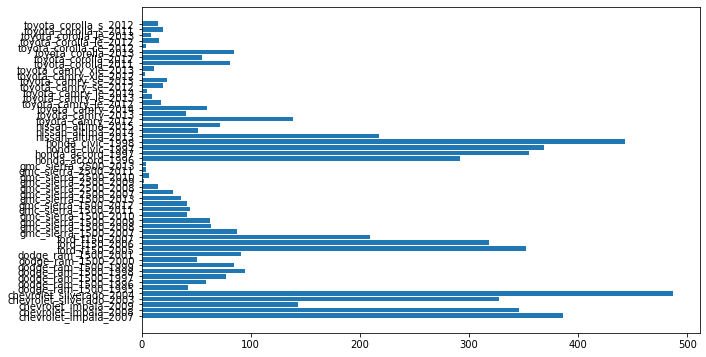

In [8]:
cols = []
col_imgs = []
for col in df.columns:
    cols.append(col)
    col_imgs.append(df[col].count())

plt.figure(figsize=(10,6))
plt.barh(cols, col_imgs)
plt.show()

- Maybe we will have to augment data

Displaying 4 ranndom image per vehicle class


C:\Users\HP\AppData\Local\Temp\ipykernel_3820\1204103456.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(20,20))


<Figure size 432x288 with 0 Axes>

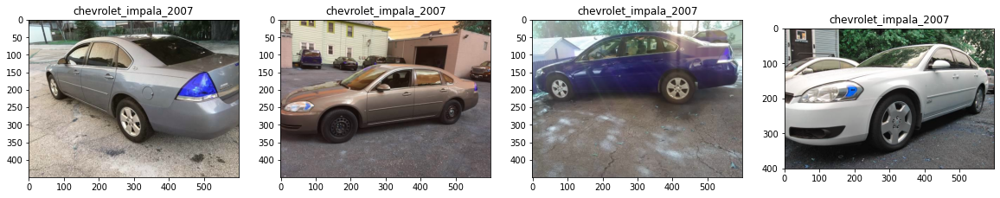

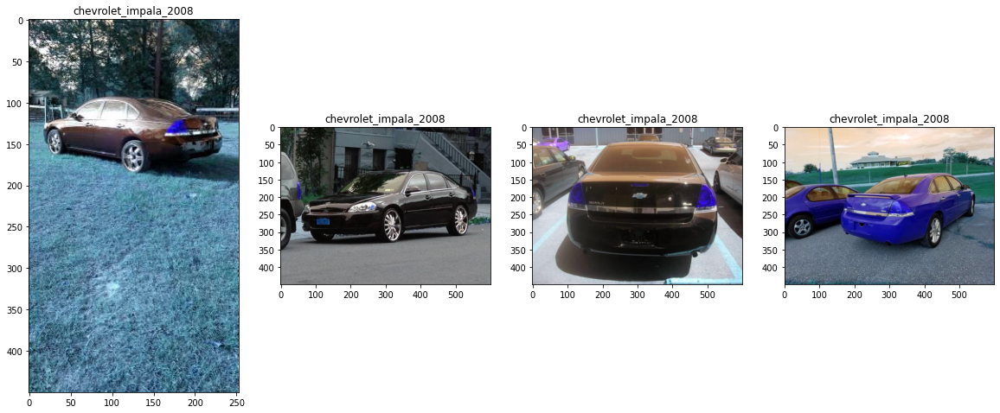

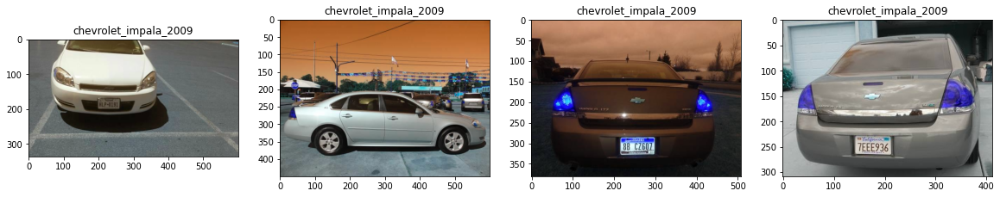

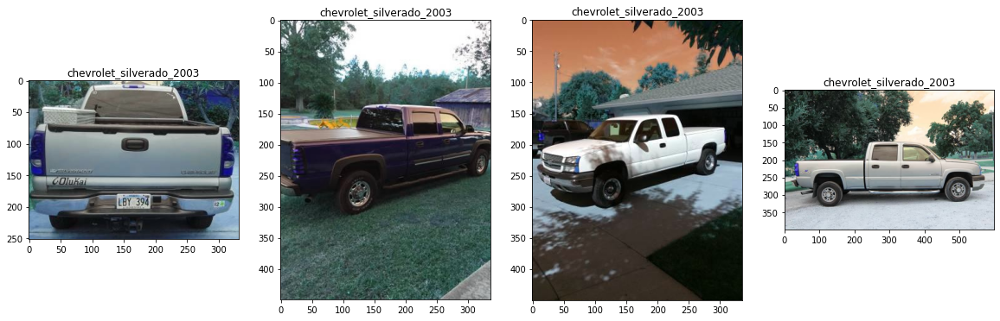

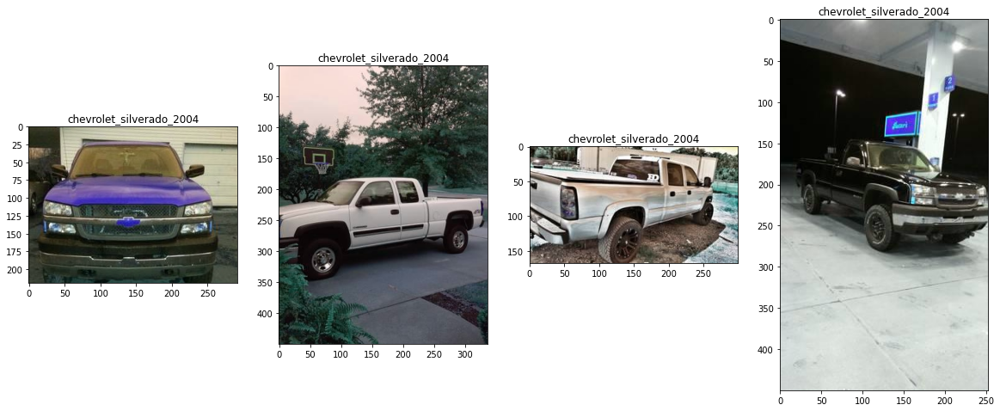

...

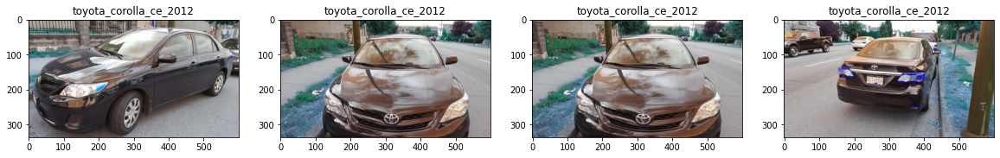

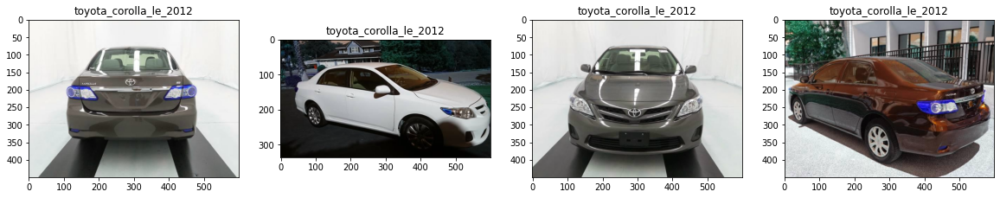

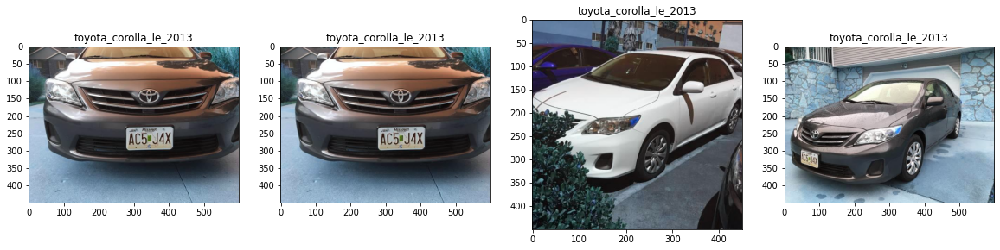

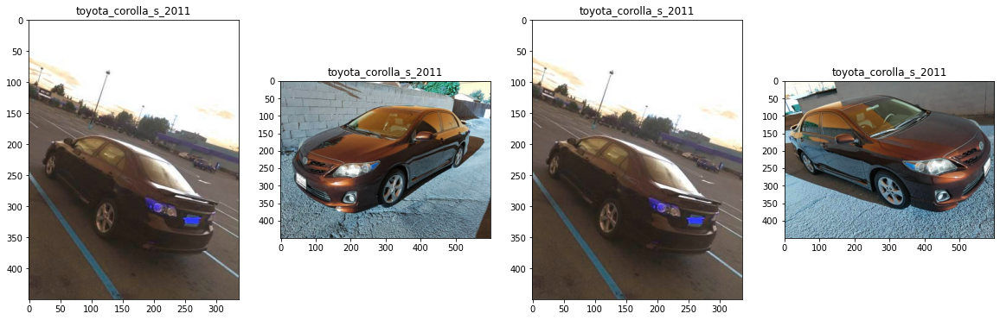

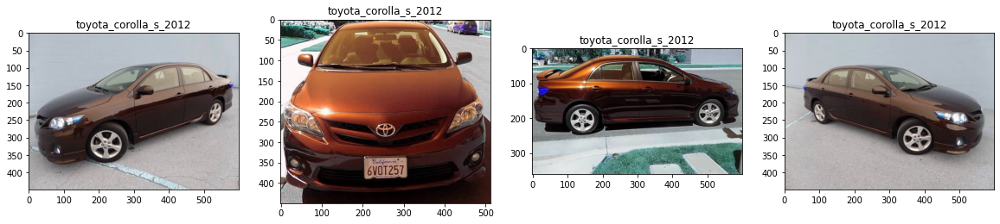

In [9]:
print("="*70)
print("Displaying 4 ranndom image per vehicle class")
print("="*70)

# for every class in `cols`
for j in range(53):
    plt.figure(j)
    plt.figure(figsize=(20,20))
    
    # 4 images per every class
    for i in range(4):
        id = "14{}".format(i+1)
        plt.subplot(int(id))
        random_file = random.choice(os.listdir(BASE + cols[j] + "/"))
        img = cv2.imread(BASE + cols[j] + "/" + random_file)
        plt.title(cols[j])
        plt.imshow(img)
plt.show()

## Prepare Data For Training

In [10]:
data = []
labels = []

In [11]:
'''
cols = sorted(cols)

# Creating trainable 224x224 images
#                    -------
for vehicle_class in cols:
    print(vehicle_class + " started .....")
    for filename in df[vehicle_class]:
        try:
            # for empty cols
            if filename == None:
                pass
            else:
                image = cv2.imread("/kaggle/input/vehicle/train/train/{}/".format(vehicle_class) + filename)
                image_from_numpy_array = Image.fromarray(image, "RGB")
                resized_image = image_from_numpy_array.resize((224, 224))
                data.append(np.array(resized_image))

                if vehicle_class == 'chevrolet_impala_2007':
                    labels.append(0)
                elif vehicle_class == 'chevrolet_impala_2008':
                    labels.append(1)
                elif vehicle_class == 'chevrolet_impala_2009':
                    labels.append(2)
                elif vehicle_class == 'chevrolet_silverado_2003':
                    labels.append(3)
                elif vehicle_class == 'chevrolet_silverado_2004':
                    labels.append(4)
                elif vehicle_class == 'dodge_ram_1500_1995':
                    labels.append(5)
                elif vehicle_class == 'dodge_ram_1500_1996':
                    labels.append(6)
                elif vehicle_class == 'dodge_ram_1500_1997':
                    labels.append(7)
                elif vehicle_class == 'dodge_ram_1500_1998':
                    labels.append(8)
                elif vehicle_class == 'dodge_ram_1500_1999':
                    labels.append(9)
                elif vehicle_class == 'dodge_ram_1500_2000':
                    labels.append(10)
                elif vehicle_class == 'dodge_ram_1500_2001':
                    labels.append(11)
                elif vehicle_class == 'ford_f150_2005':
                    labels.append(12)
                elif vehicle_class == 'ford_f150_2006':
                    labels.append(13)
                elif vehicle_class == 'ford_f150_2007':
                    labels.append(14)
                elif vehicle_class == 'gmc_sierra_1500_2007':
                    labels.append(15)
                elif vehicle_class == 'gmc_sierra_1500_2008':
                    labels.append(16)
                elif vehicle_class == 'gmc_sierra_1500_2009':
                    labels.append(17)
                elif vehicle_class == 'gmc_sierra_1500_2010':
                    labels.append(18)
                elif vehicle_class == 'gmc_sierra_1500_2011':
                    labels.append(19)
                elif vehicle_class == 'gmc_sierra_1500_2012':
                    labels.append(20)
                elif vehicle_class == 'gmc_sierra_1500_2013':
                    labels.append(21)
                elif vehicle_class == 'gmc_sierra_2500_2007':
                    labels.append(22)
                elif vehicle_class == 'gmc_sierra_2500_2008':
                    labels.append(23)
                elif vehicle_class == 'gmc_sierra_2500_2009':
                    labels.append(24)
                elif vehicle_class == 'gmc_sierra_2500_2010':
                    labels.append(25)
                elif vehicle_class == 'gmc_sierra_2500_2011':
                    labels.append(26)
                elif vehicle_class == 'gmc_sierra_2500_2013':
                    labels.append(27)
                elif vehicle_class == 'honda_accord_1996':
                    labels.append(28)
                elif vehicle_class == 'honda_accord_1997':
                    labels.append(29)
                elif vehicle_class == 'honda_civic_1997':
                    labels.append(30)
                elif vehicle_class == 'honda_civic_1998':
                    labels.append(31)
                elif vehicle_class == 'nissan_altima_2013':
                    labels.append(32)
                elif vehicle_class == 'nissan_altima_2014':
                    labels.append(33)
                elif vehicle_class == 'nissan_altima_2015':
                    labels.append(34)
                elif vehicle_class == 'toyota_camry_2012':
                    labels.append(35)
                elif vehicle_class == 'toyota_camry_2013':
                    labels.append(36)
                elif vehicle_class == 'toyota_camry_2014':
                    labels.append(37)
                elif vehicle_class == 'toyota_camry_le_2012':
                    labels.append(38)
                elif vehicle_class == 'toyota_camry_le_2013':
                    labels.append(39)
                elif vehicle_class == 'toyota_camry_le_2014':
                    labels.append(40)
                elif vehicle_class == 'toyota_camry_se_2012':
                    labels.append(41)
                elif vehicle_class == 'toyota_camry_se_2013':
                    labels.append(42)
                elif vehicle_class == 'toyota_camry_xle_2012':
                    labels.append(43)
                elif vehicle_class == 'toyota_camry_xle_2013':
                    labels.append(44)
                elif vehicle_class == 'toyota_corolla_2011':
                    labels.append(45)
                elif vehicle_class == 'toyota_corolla_2012':
                    labels.append(46)
                elif vehicle_class == 'toyota_corolla_2013':
                    labels.append(47)
                elif vehicle_class == 'toyota_corolla_ce_2012':
                    labels.append(48)
                elif vehicle_class == 'toyota_corolla_le_2012':
                    labels.append(49)
                elif vehicle_class == 'toyota_corolla_le_2013':
                    labels.append(50)
                elif vehicle_class == 'toyota_corolla_s_2011':
                    labels.append(51)
                elif vehicle_class == 'toyota_corolla_s_2012':
                    labels.append(52)
                else:
                    print("Something is wrong.")
                
        except AttributeError:
            print("Attribute error occured for "+filename)
'''

'\ncols = sorted(cols)\n\n# Creating trainable 224x224 images\n#                    -------\nfor vehicle_class in cols:\n    print(vehicle_class + " started .....")\n    for filename in df[vehicle_class]:\n        try:\n            # for empty cols\n            if filename == None:\n                pass\n            else:\n                image = cv2.imread("/kaggle/input/vehicle/train/train/{}/".format(vehicle_class) + filename)\n                image_from_numpy_array = Image.fromarray(image, "RGB")\n                resized_image = image_from_numpy_array.resize((224, 224))\n                data.append(np.array(resized_image))\n\n                if vehicle_class == \'chevrolet_impala_2007\':\n                    labels.append(0)\n                elif vehicle_class == \'chevrolet_impala_2008\':\n                    labels.append(1)\n                elif vehicle_class == \'chevrolet_impala_2009\':\n                    labels.append(2)\n                elif vehicle_class == \'chevrolet_si

In [12]:
'''
vehicle_images_224x224 = np.array(data)
labels_224x224 = np.array(labels)

# save
np.save("all-vehicle-224x224-images-as-arrays", vehicle_images_224x224)
np.save("corresponding-labels-for-all-224x224-images", labels_224x224)
'''

'\nvehicle_images_224x224 = np.array(data)\nlabels_224x224 = np.array(labels)\n\n# save\nnp.save("all-vehicle-224x224-images-as-arrays", vehicle_images_224x224)\nnp.save("corresponding-labels-for-all-224x224-images", labels_224x224)\n'

In [13]:
#data = np.load("all-vehicle-224x224-images-as-arrays.npy")
#labels = np.load("corresponding-labels-for-all-224x224-images.npy")

In [14]:
'''
print(vehicle_images_224x224.shape)
print(labels_224x224.shape)
print(np.unique(labels_224x224))
'''

'\nprint(vehicle_images_224x224.shape)\nprint(labels_224x224.shape)\nprint(np.unique(labels_224x224))\n'

------

In [15]:
!rd -r "d:/project/kaggle/working/data"

The system cannot find the file specified.
The system cannot find the file specified.


In [16]:
# Move images to `test` and `train` dir
import shutil
import os

os.mkdir("d:/project/kaggle/working/data")
os.mkdir("d:/project/kaggle/working/data/test")
os.mkdir("d:/project/kaggle/working/data/train")

classes = ['chevrolet_impala_2007', 'chevrolet_impala_2008', 'dodge_ram_1500_1995', 'ford_f150_2005', 'gmc_sierra_1500_2007', 'gmc_sierra_2500_2007', 'toyota_camry_2014']

for dir in ["test", "train"]:
    for _class in classes:
        os.mkdir("d:/project/kaggle/working/data/{}/{}".format(dir, _class))

for _class in classes:
    images = os.listdir("d:/project/kaggle/input/vehicle/train/train/{}".format(_class))

    test = images[:300]
    
    # downsample to 1.5k images
    if len(images) < 1500:
      train = images[300:]
    else:
      train = images[300:1500]

    # move images to test-set folder
    for image in test:
        shutil.copy("d:/project/kaggle/input/vehicle/train/train/{}/{}".format(_class, image), "d:/project/kaggle/working/data/test/{}/{}".format(_class, image))

    # move images to train-set folder
    for image in train:
        shutil.copy("d:/project/kaggle/input/vehicle/train/train/{}/{}".format(_class, image), "d:/project/kaggle/working/data/train/{}/{}".format(_class, image))

In [17]:
import numpy as np
%matplotlib inline
import matplotlib.pyplot as plt
from PIL import Image

In [18]:
import keras
from keras.preprocessing.image import ImageDataGenerator
from keras.applications import ResNet50
from keras.applications.resnet import preprocess_input
from keras import Model, layers
from keras.models import load_model, model_from_json

In [19]:
input_path = "d:/project/kaggle/working/data/"

In [20]:
train_datagen = ImageDataGenerator(
    shear_range=10,
    zoom_range=0.2,
    horizontal_flip=True,
    preprocessing_function=preprocess_input)

train_generator = train_datagen.flow_from_directory(
    input_path + 'train',
    batch_size=32,
    #class_mode='binary',
    target_size=(224,224))

validation_datagen = ImageDataGenerator(
    preprocessing_function=preprocess_input)

validation_generator = validation_datagen.flow_from_directory(
    input_path + 'test',
    shuffle=False,
    #class_mode='binary',
    target_size=(224,224))

Found 184 images belonging to 7 classes.
Found 1119 images belonging to 7 classes.


In [21]:
conv_base = ResNet50(
    include_top=False,
    weights='imagenet')

for layer in conv_base.layers:
    layer.trainable = False

In [22]:
x = conv_base.output
x = layers.GlobalAveragePooling2D()(x)
x = layers.Dense(1024, activation='relu')(x)
x = layers.Dense(512, activation='relu')(x)
predictions = layers.Dense(7, activation='softmax')(x)
model = Model(conv_base.input, predictions)

In [23]:
optimizer = keras.optimizers.Adam()
model.compile(loss='categorical_crossentropy',
              optimizer=optimizer,
              metrics=['accuracy'])

In [29]:
history = model.fit(x=train_generator,
                              steps_per_epoch=5,  
                              epochs=30,
                              validation_data=validation_generator,
                              validation_steps=10  
                             )

Epoch 1/30
5/5 [==============================] - 70s 16s/step - loss: 0.4524 - accuracy: 0.7875 - val_loss: 0.9116 - val_accuracy: 0.4156
Epoch 2/30
5/5 [==============================] - 70s 16s/step - loss: 0.4100 - accuracy: 0.8289 - val_loss: 0.7717 - val_accuracy: 0.5250
Epoch 3/30
5/5 [==============================] - 79s 19s/step - loss: 0.3628 - accuracy: 0.8289 - val_loss: 0.9062 - val_accuracy: 0.4688
Epoch 4/30
5/5 [==============================] - 74s 17s/step - loss: 0.3403 - accuracy: 0.8625 - val_loss: 0.5685 - val_accuracy: 0.7406
Epoch 5/30
5/5 [==============================] - 74s 17s/step - loss: 0.3260 - accuracy: 0.8618 - val_loss: 1.7075 - val_accuracy: 0.1531
Epoch 6/30
5/5 [==============================] - 74s 17s/step - loss: 0.4180 - accuracy: 0.8026 - val_loss: 0.5931 - val_accuracy: 0.7406
Epoch 7/30
5/5 [==============================] - 74s 17s/step - loss: 0.3409 - accuracy: 0.8487 - val_loss: 0.8645 - val_accuracy: 0.4875
Epoch 8/30
5/5 [===========

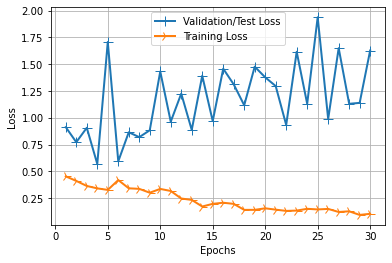

In [30]:
# plot loss chart
import matplotlib.pyplot as plt

history_dict = history.history

loss_values = history_dict['loss']
val_loss_values = history_dict['val_loss']
epochs = range(1, len(loss_values) + 1)

line1 = plt.plot(epochs, val_loss_values, label='Validation/Test Loss')
line2 = plt.plot(epochs, loss_values, label='Training Loss')
plt.setp(line1, linewidth=2.0, marker = '+', markersize=10.0)
plt.setp(line2, linewidth=2.0, marker = '4', markersize=10.0)
plt.xlabel('Epochs') 
plt.ylabel('Loss')
plt.grid(True)
plt.legend()
plt.show()

In [31]:
del model
del history

In [32]:
x = conv_base.output
x = layers.GlobalAveragePooling2D()(x)
x = layers.Dense(128, activation='relu')(x) 
predictions = layers.Dense(7, activation='softmax')(x)
model = Model(conv_base.input, predictions)

optimizer = keras.optimizers.Adam()
model.compile(loss='categorical_crossentropy',
              optimizer=optimizer,
              metrics=['accuracy'])

history = model.fit_generator(generator=train_generator,
                              steps_per_epoch=5,  # added in Kaggle
                              epochs=30,
                              validation_data=validation_generator,
                              validation_steps=10  # added in Kaggle
                             )

C:\Users\HP\AppData\Local\Temp\ipykernel_3820\1370193824.py:12: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  history = model.fit_generator(generator=train_generator,


Epoch 1/30
5/5 [==============================] - 59s 13s/step - loss: 1.4687 - accuracy: 0.4500 - val_loss: 0.8614 - val_accuracy: 0.5125
Epoch 2/30
5/5 [==============================] - 55s 13s/step - loss: 0.6456 - accuracy: 0.6711 - val_loss: 0.9506 - val_accuracy: 0.5250
Epoch 3/30
5/5 [==============================] - 56s 13s/step - loss: 0.4914 - accuracy: 0.7566 - val_loss: 1.1295 - val_accuracy: 0.3781
Epoch 4/30
5/5 [==============================] - 55s 13s/step - loss: 0.4841 - accuracy: 0.7434 - val_loss: 1.1664 - val_accuracy: 0.3562
Epoch 5/30
5/5 [==============================] - 64s 15s/step - loss: 0.3903 - accuracy: 0.8421 - val_loss: 0.6256 - val_accuracy: 0.6906
Epoch 6/30
5/5 [==============================] - 61s 14s/step - loss: 0.3580 - accuracy: 0.8355 - val_loss: 1.9847 - val_accuracy: 0.1875
Epoch 7/30
5/5 [==============================] - 61s 14s/step - loss: 0.3313 - accuracy: 0.8487 - val_loss: 1.1926 - val_accuracy: 0.4094
Epoch 8/30
5/5 [===========

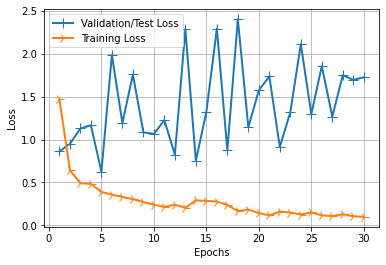

In [34]:
# plot loss chart
import matplotlib.pyplot as plt

history_dict = history.history

loss_values = history_dict['loss']
val_loss_values = history_dict['val_loss']
epochs = range(1, len(loss_values) + 1)

line1 = plt.plot(epochs, val_loss_values, label='Validation/Test Loss')
line2 = plt.plot(epochs, loss_values, label='Training Loss')
plt.setp(line1, linewidth=2.0, marker = '+', markersize=10.0)
plt.setp(line2, linewidth=2.0, marker = '4', markersize=10.0)
plt.xlabel('Epochs') 
plt.ylabel('Loss')
plt.grid(True)
plt.legend()
plt.show()

In [35]:
del model
del history

In [37]:
conv_base = ResNet50(
    include_top=False,
    weights='imagenet')

for layer in conv_base.layers:
    layer.trainable = False

x = conv_base.output
x = layers.GlobalAveragePooling2D()(x)
x = layers.Dense(128, activation='relu')(x) 
predictions = layers.Dense(7, activation='softmax')(x)
model = Model(conv_base.input, predictions)

optimizer = keras.optimizers.Adam(learning_rate=0.000001)
model.compile(loss='categorical_crossentropy',
              optimizer=optimizer,
              metrics=['accuracy'])

history = model.fit_generator(generator=train_generator,
                              steps_per_epoch=5,  # added in Kaggle
                              epochs=30,
                              validation_data=validation_generator,
                              validation_steps=10  # added in Kaggle
                             )

C:\Users\HP\AppData\Local\Temp\ipykernel_3820\1374234051.py:19: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  history = model.fit_generator(generator=train_generator,


Epoch 1/30
5/5 [==============================] - 59s 13s/step - loss: 2.3115 - accuracy: 0.2105 - val_loss: 3.1797 - val_accuracy: 0.0219
Epoch 2/30
5/5 [==============================] - 56s 13s/step - loss: 2.3929 - accuracy: 0.1750 - val_loss: 3.1611 - val_accuracy: 0.0219
Epoch 3/30
5/5 [==============================] - 56s 13s/step - loss: 2.2968 - accuracy: 0.2303 - val_loss: 3.1416 - val_accuracy: 0.0219
Epoch 4/30
5/5 [==============================] - 60s 14s/step - loss: 2.3192 - accuracy: 0.1974 - val_loss: 3.1224 - val_accuracy: 0.0219
Epoch 5/30
5/5 [==============================] - 61s 14s/step - loss: 2.3392 - accuracy: 0.2105 - val_loss: 3.1033 - val_accuracy: 0.0219
Epoch 6/30
5/5 [==============================] - 61s 14s/step - loss: 2.3029 - accuracy: 0.2105 - val_loss: 3.0837 - val_accuracy: 0.0219
Epoch 7/30
5/5 [==============================] - 61s 14s/step - loss: 2.3351 - accuracy: 0.1908 - val_loss: 3.0647 - val_accuracy: 0.0219
Epoch 8/30
5/5 [===========

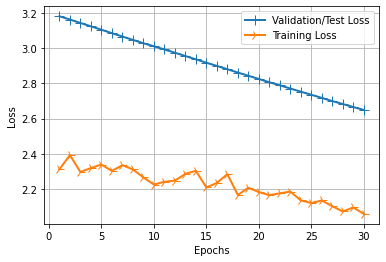

In [38]:
# plot loss chart
import matplotlib.pyplot as plt

history_dict = history.history

loss_values = history_dict['loss']
val_loss_values = history_dict['val_loss']
epochs = range(1, len(loss_values) + 1)

line1 = plt.plot(epochs, val_loss_values, label='Validation/Test Loss')
line2 = plt.plot(epochs, loss_values, label='Training Loss')
plt.setp(line1, linewidth=2.0, marker = '+', markersize=10.0)
plt.setp(line2, linewidth=2.0, marker = '4', markersize=10.0)
plt.xlabel('Epochs') 
plt.ylabel('Loss')
plt.grid(True)
plt.legend()
plt.show()

In [39]:
del model
del history

In [48]:
conv_base = ResNet50(
    include_top=False,
    weights='imagenet')

for layer in conv_base.layers:
    layer.trainable = False

x = conv_base.output
x = layers.GlobalAveragePooling2D()(x)
x = layers.Dense(128, activation='relu')(x) 
predictions = layers.Dense(7, activation='softmax')(x)
model = Model(conv_base.input, predictions)

optimizer = keras.optimizers.Adam(lr=1e-2, beta_1=1e-2/60)
model.compile(loss='categorical_crossentropy',
              optimizer=optimizer,
              metrics=['accuracy'])

history = model.fit_generator(generator=train_generator,
                              steps_per_epoch=5,  # added in Kaggle
                              epochs=60,
                              validation_data=validation_generator,
                              validation_steps=10  # added in Kaggle
                             )

C:\Users\HP\AppData\Local\Temp\ipykernel_3820\2619606867.py:19: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  history = model.fit_generator(generator=train_generator,


Epoch 1/60
5/5 [==============================] - 66s 14s/step - loss: 7.9354 - accuracy: 0.3289 - val_loss: 4.5807 - val_accuracy: 0.0000e+00
Epoch 2/60
5/5 [==============================] - 63s 15s/step - loss: 4.2213 - accuracy: 0.4408 - val_loss: 9.1714 - val_accuracy: 0.0625
Epoch 3/60
5/5 [==============================] - 61s 14s/step - loss: 3.3574 - accuracy: 0.4625 - val_loss: 3.0834 - val_accuracy: 0.1562
Epoch 4/60
5/5 [==============================] - 58s 14s/step - loss: 0.9691 - accuracy: 0.6776 - val_loss: 0.8877 - val_accuracy: 0.6875
Epoch 5/60
5/5 [==============================] - 61s 14s/step - loss: 0.5434 - accuracy: 0.7566 - val_loss: 0.5566 - val_accuracy: 0.8438
Epoch 6/60
5/5 [==============================] - 61s 14s/step - loss: 0.5349 - accuracy: 0.7171 - val_loss: 1.2224 - val_accuracy: 0.0938
Epoch 7/60
5/5 [==============================] - 62s 15s/step - loss: 1.5700 - accuracy: 0.5724 - val_loss: 8.8933 - val_accuracy: 0.0000e+00
Epoch 8/60
5/5 [===

5/5 [==============================] - 71s 17s/step - loss: 0.3522 - accuracy: 0.8421 - val_loss: 0.6447 - val_accuracy: 0.6938
Epoch 60/60
5/5 [==============================] - 72s 17s/step - loss: 0.3795 - accuracy: 0.7895 - val_loss: 0.4100 - val_accuracy: 0.8438


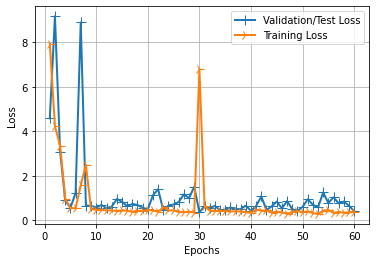

In [49]:
# plot loss chart
import matplotlib.pyplot as plt

history_dict = history.history

loss_values = history_dict['loss']
val_loss_values = history_dict['val_loss']
epochs = range(1, len(loss_values) + 1)

line1 = plt.plot(epochs, val_loss_values, label='Validation/Test Loss')
line2 = plt.plot(epochs, loss_values, label='Training Loss')
plt.setp(line1, linewidth=2.0, marker = '+', markersize=10.0)
plt.setp(line2, linewidth=2.0, marker = '4', markersize=10.0)
plt.xlabel('Epochs') 
plt.ylabel('Loss')
plt.grid(True)
plt.legend()
plt.show()

In [50]:
del model
del history

In [51]:
conv_base = ResNet50(
    include_top=False,
    weights='imagenet')

for layer in conv_base.layers:
    layer.trainable = False

x = conv_base.output
x = layers.GlobalAveragePooling2D()(x)
x = layers.Dense(128, activation='relu')(x) 
predictions = layers.Dense(7, activation='softmax')(x)
model = Model(conv_base.input, predictions)

optimizer = keras.optimizers.Adam(learning_rate=0.001, beta_1=0.9, beta_2=0.999, amsgrad=False)
model.compile(loss='categorical_crossentropy',
              optimizer=optimizer,
              metrics=['accuracy'])

history = model.fit_generator(generator=train_generator,
                              steps_per_epoch=5,  # added in Kaggle
                              epochs=60,
                              validation_data=validation_generator,
                              validation_steps=10  # added in Kaggle
                             )

C:\Users\HP\AppData\Local\Temp\ipykernel_3820\3377862549.py:19: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  history = model.fit_generator(generator=train_generator,


Epoch 1/60
5/5 [==============================] - 65s 14s/step - loss: 1.2128 - accuracy: 0.5197 - val_loss: 0.5901 - val_accuracy: 0.8531
Epoch 2/60
5/5 [==============================] - 65s 15s/step - loss: 0.5960 - accuracy: 0.7188 - val_loss: 0.7523 - val_accuracy: 0.6094
Epoch 3/60
5/5 [==============================] - 71s 16s/step - loss: 0.4976 - accuracy: 0.7566 - val_loss: 0.9761 - val_accuracy: 0.4812
Epoch 4/60
5/5 [==============================] - 71s 16s/step - loss: 0.4523 - accuracy: 0.7829 - val_loss: 1.6763 - val_accuracy: 0.1750
Epoch 5/60
5/5 [==============================] - 71s 17s/step - loss: 0.4017 - accuracy: 0.7961 - val_loss: 1.0795 - val_accuracy: 0.3781
Epoch 6/60
5/5 [==============================] - 71s 17s/step - loss: 0.3391 - accuracy: 0.8421 - val_loss: 0.7941 - val_accuracy: 0.6313
Epoch 7/60
5/5 [==============================] - 72s 17s/step - loss: 0.3030 - accuracy: 0.8553 - val_loss: 1.8707 - val_accuracy: 0.1781
Epoch 8/60
5/5 [===========

5/5 [==============================] - 77s 18s/step - loss: 0.0443 - accuracy: 0.9934 - val_loss: 1.6966 - val_accuracy: 0.4812
Epoch 60/60
5/5 [==============================] - 77s 18s/step - loss: 0.0417 - accuracy: 0.9868 - val_loss: 3.4461 - val_accuracy: 0.2250


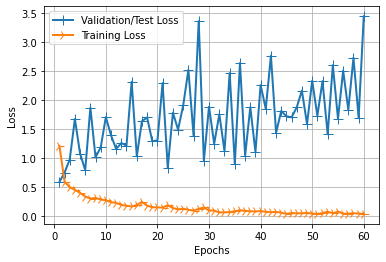

In [52]:
# plot loss chart
import matplotlib.pyplot as plt

history_dict = history.history

loss_values = history_dict['loss']
val_loss_values = history_dict['val_loss']
epochs = range(1, len(loss_values) + 1)

line1 = plt.plot(epochs, val_loss_values, label='Validation/Test Loss')
line2 = plt.plot(epochs, loss_values, label='Training Loss')
plt.setp(line1, linewidth=2.0, marker = '+', markersize=10.0)
plt.setp(line2, linewidth=2.0, marker = '4', markersize=10.0)
plt.xlabel('Epochs') 
plt.ylabel('Loss')
plt.grid(True)
plt.legend()
plt.show()

In [53]:
del model
del history

In [54]:
conv_base = ResNet50(
    include_top=False,
    weights='imagenet')

for layer in conv_base.layers:
    layer.trainable = False

x = conv_base.output
x = layers.GlobalAveragePooling2D()(x)
x = layers.Dense(128, activation='relu')(x) 
predictions = layers.Dense(7, activation='softmax')(x)
model = Model(conv_base.input, predictions)

# Note sgd 
optimizer = keras.optimizers.SGD(lr=1e-2, momentum=0.9, decay=1e-2/60)
model.compile(loss='categorical_crossentropy',
              optimizer=optimizer,
              metrics=['accuracy'])

history = model.fit_generator(generator=train_generator,
                              steps_per_epoch=5,  
                              epochs=60,
                              validation_data=validation_generator,
                              validation_steps=10  
                             )

C:\Python310\lib\site-packages\keras\optimizers\optimizer_v2\gradient_descent.py:108: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)
C:\Users\HP\AppData\Local\Temp\ipykernel_3820\1096135118.py:20: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  history = model.fit_generator(generator=train_generator,


Epoch 1/60
5/5 [==============================] - 63s 14s/step - loss: 2.1813 - accuracy: 0.3816 - val_loss: 3.4771 - val_accuracy: 0.0344
Epoch 2/60
5/5 [==============================] - 60s 14s/step - loss: 1.4167 - accuracy: 0.5592 - val_loss: 0.5042 - val_accuracy: 0.9031
Epoch 3/60
5/5 [==============================] - 61s 14s/step - loss: 1.1030 - accuracy: 0.6645 - val_loss: 0.9900 - val_accuracy: 0.0688
Epoch 4/60
5/5 [==============================] - 69s 16s/step - loss: 0.7703 - accuracy: 0.5987 - val_loss: 0.7510 - val_accuracy: 0.8438
Epoch 5/60
5/5 [==============================] - 66s 15s/step - loss: 0.5887 - accuracy: 0.7500 - val_loss: 0.3831 - val_accuracy: 0.9062
Epoch 6/60
5/5 [==============================] - 82s 19s/step - loss: 0.5168 - accuracy: 0.7500 - val_loss: 0.8192 - val_accuracy: 0.6000
Epoch 7/60
5/5 [==============================] - 87s 21s/step - loss: 0.5167 - accuracy: 0.7039 - val_loss: 0.9551 - val_accuracy: 0.2500
Epoch 8/60
5/5 [===========

5/5 [==============================] - 64s 15s/step - loss: 0.0999 - accuracy: 0.9605 - val_loss: 2.4758 - val_accuracy: 0.3250
Epoch 60/60
5/5 [==============================] - 65s 15s/step - loss: 0.0909 - accuracy: 0.9605 - val_loss: 2.9216 - val_accuracy: 0.2625


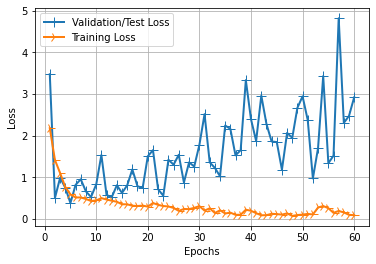

In [55]:
# plot loss chart
import matplotlib.pyplot as plt

history_dict = history.history

loss_values = history_dict['loss']
val_loss_values = history_dict['val_loss']
epochs = range(1, len(loss_values) + 1)

line1 = plt.plot(epochs, val_loss_values, label='Validation/Test Loss')
line2 = plt.plot(epochs, loss_values, label='Training Loss')
plt.setp(line1, linewidth=2.0, marker = '+', markersize=10.0)
plt.setp(line2, linewidth=2.0, marker = '4', markersize=10.0)
plt.xlabel('Epochs') 
plt.ylabel('Loss')
plt.grid(True)
plt.legend()
plt.show()

In [56]:
del model
del history          

In [57]:
conv_base = ResNet50(
    include_top=False,
    weights='imagenet')

for layer in conv_base.layers:
    layer.trainable = False

x = conv_base.output
x = layers.GlobalAveragePooling2D()(x)
x = layers.Dense(1024, activation='relu')(x)
x = layers.Dropout(0.5)(x)
x = layers.Dense(256, activation='relu')(x)
x = layers.Dropout(0.5)(x)
predictions = layers.Dense(7, activation='softmax')(x)
model = Model(conv_base.input, predictions)

optimizer = keras.optimizers.Adam()
model.compile(loss='categorical_crossentropy',
              optimizer=optimizer,
              metrics=['accuracy'])

history = model.fit_generator(generator=train_generator,
                              steps_per_epoch=5,  
                              epochs=60,
                              validation_data=validation_generator,
                              validation_steps=10  # added in Kaggle
                             )

C:\Users\HP\AppData\Local\Temp\ipykernel_3820\3658141172.py:22: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  history = model.fit_generator(generator=train_generator,


Epoch 1/60
5/5 [==============================] - 68s 15s/step - loss: 2.6340 - accuracy: 0.3313 - val_loss: 0.8623 - val_accuracy: 0.6406
Epoch 2/60
5/5 [==============================] - 61s 14s/step - loss: 1.6670 - accuracy: 0.4625 - val_loss: 0.8897 - val_accuracy: 0.4688
Epoch 3/60
5/5 [==============================] - 61s 14s/step - loss: 1.3551 - accuracy: 0.4803 - val_loss: 0.4527 - val_accuracy: 0.8687
Epoch 4/60
5/5 [==============================] - 69s 16s/step - loss: 1.1899 - accuracy: 0.6125 - val_loss: 0.6437 - val_accuracy: 0.8125
Epoch 5/60
5/5 [==============================] - 75s 18s/step - loss: 1.0175 - accuracy: 0.5329 - val_loss: 0.6814 - val_accuracy: 0.8094
Epoch 6/60
5/5 [==============================] - 74s 17s/step - loss: 0.7519 - accuracy: 0.6382 - val_loss: 0.6029 - val_accuracy: 0.8625
Epoch 7/60
5/5 [==============================] - 74s 17s/step - loss: 0.7118 - accuracy: 0.6645 - val_loss: 0.9048 - val_accuracy: 0.1656
Epoch 8/60
5/5 [===========

5/5 [==============================] - 66s 15s/step - loss: 0.2205 - accuracy: 0.8947 - val_loss: 2.0882 - val_accuracy: 0.3281
Epoch 60/60
5/5 [==============================] - 80s 18s/step - loss: 0.2094 - accuracy: 0.9145 - val_loss: 1.8275 - val_accuracy: 0.3844


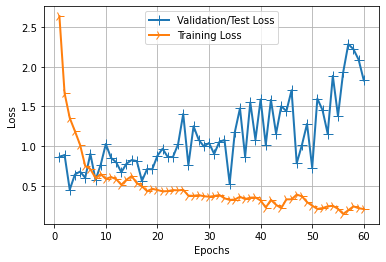

In [58]:
# plot loss chart
import matplotlib.pyplot as plt

history_dict = history.history

loss_values = history_dict['loss']
val_loss_values = history_dict['val_loss']
epochs = range(1, len(loss_values) + 1)

line1 = plt.plot(epochs, val_loss_values, label='Validation/Test Loss')
line2 = plt.plot(epochs, loss_values, label='Training Loss')
plt.setp(line1, linewidth=2.0, marker = '+', markersize=10.0)
plt.setp(line2, linewidth=2.0, marker = '4', markersize=10.0)
plt.xlabel('Epochs') 
plt.ylabel('Loss')
plt.grid(True)
plt.legend()
plt.show()

- use dropout
- [x] try sgd - pyimg
- try vgg, googlenet, efficient net